In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as pxs
import plotly.subplots as make_subplots
import json
from tqdm import tqdm
from collections import Counter

In [2]:
severe = pd.read_csv("Data/SYMPTOMS_SEVERE.csv")
severe

,Symptoms,Severity_level
0,anxiety and nervousness,2
1,depression,2
2,shortness of breath,3
3,depressive or psychotic symptoms,3
4,sharp chest pain,3
...,...,...
372,hip weakness,2
373,back swelling,2
374,ankle stiffness or tightness,2
375,ankle weakness,2


In [3]:
data = pd.read_csv("Data/Dataset_Diseases/Dataset_Diseases/Final_Augmented_dataset_Diseases_and_Symptoms.csv")
data

,diseases,anxiety and nervousness,depression,shortness of breath,depressive or psychotic symptoms,sharp chest pain,dizziness,insomnia,abnormal involuntary movements,chest tightness,...,stuttering or stammering,problems with orgasm,nose deformity,lump over jaw,sore in nose,hip weakness,back swelling,ankle stiffness or tightness,ankle weakness,neck weakness
0,panic disorder,1,0,1,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1,panic disorder,0,0,1,1,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,panic disorder,1,1,1,1,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
3,panic disorder,1,0,0,1,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
4,panic disorder,1,1,0,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246940,open wound of the nose,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
246941,open wound of the nose,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
246942,open wound of the nose,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
246943,open wound of the nose,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
symptoms = data.iloc[:,1:].columns
diseases = data["diseases"].unique()

In [13]:
symptoms.values[300:377]

array(['itching of the anus', 'swollen or red tonsils',
       'irregular belly button', 'swollen tongue', 'lip sore',
       'vulvar sore', 'hip stiffness or tightness', 'mouth pain',
       'arm weakness', 'leg lump or mass',
       'disturbance of smell or taste', 'discharge in stools',
       'penis pain', 'loss of sex drive', 'obsessions and compulsions',
       'antisocial behavior', 'neck cramps or spasms', 'pupils unequal',
       'poor circulation', 'thirst', 'sleepwalking', 'skin oiliness',
       'sneezing', 'bladder mass', 'knee cramps or spasms',
       'premature ejaculation', 'leg weakness', 'posture problems',
       'bleeding in mouth', 'tongue bleeding',
       'change in skin mole size or color', 'penis redness',
       'penile discharge', 'shoulder lump or mass', 'polyuria',
       'cloudy eye', 'hysterical behavior', 'arm lump or mass',
       'nightmares', 'bleeding gums', 'pain in gums', 'bedwetting',
       'diaper rash', 'lump or mass of breast',
       'vagina

In [6]:
# Converting Each Diseases and corresponding symptoms into a dataset
eda_data = list()
for i in tqdm(diseases):
    temp = data[data["diseases"]==i]
    new = []
    for k in range(len(temp)):
        sym = temp.iloc[k,0:]
        sym_data = sym.reset_index().set_index("index")
        sym_org = sym.reset_index()
        n = []
        for idx,row in sym_org.iterrows():
                lst = []
                for c,v in row.items():
                    lst.append(v)
                    if len(lst)>1:
                        if lst[1]==1:
                            n.append([lst[0]])
        new.append(n)
    eda = pd.DataFrame(new[l] for l in range(len(new)))
    eda["Diseases"] = i
    eda.to_csv(f"Data/Preprocessed_each_diseases_symptoms/{i}.csv",index=False)    

100%|██████████████████████████████████████████████████████████████████████████████| 773/773 [1:07:59<00:00,  5.28s/it]


In [7]:
# finding counts of symptoms for diseases
# sym_list = []
# for i in eda.columns[:-1]:
#     sym_list.extend(eda[i].dropna())
# symptoms = [str(i).strip("[]") for i in sym_list]
# counts = Counter(symptoms)
# counts

Counter({"'depressive or psychotic symptoms'": 620,
         "'dizziness'": 478,
         "'insomnia'": 470,
         "'abnormal involuntary movements'": 469,
         "'breathing fast'": 468,
         "'chest tightness'": 462,
         "'irregular heartbeat'": 455,
         "'anxiety and nervousness'": 451,
         "'depression'": 451,
         "'palpitations'": 451,
         "'shortness of breath'": 445})

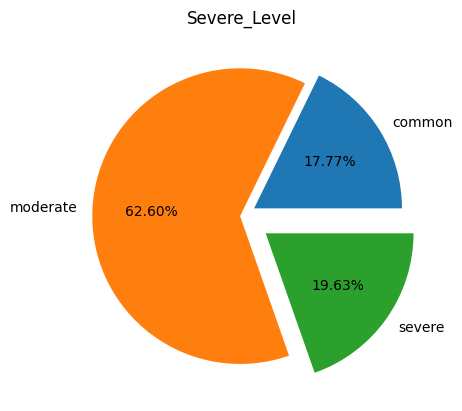

In [4]:
fig = severe.groupby(['Severity_level']).size().plot(kind='pie',autopct="%.2f%%",title="Severe_Level",labels=["common",'moderate','severe'],explode=(.1,.01,.2))
figs = fig.get_figure()
figs.savefig("Visuals/EDA/Severe_LVLS.png")

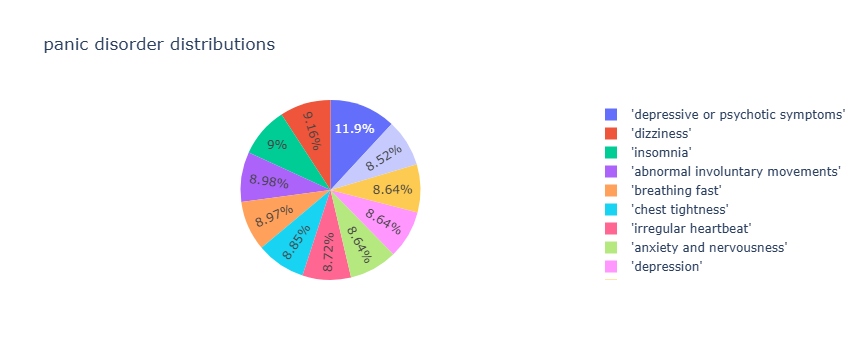

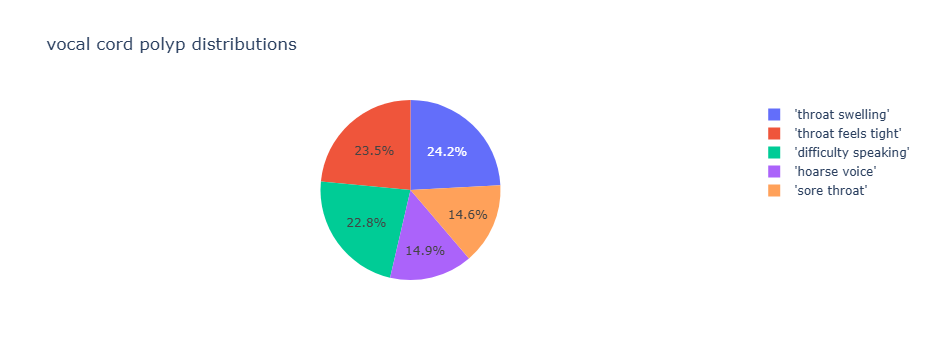

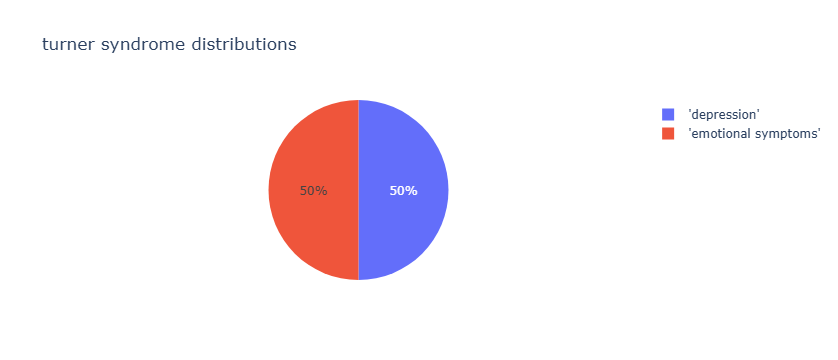

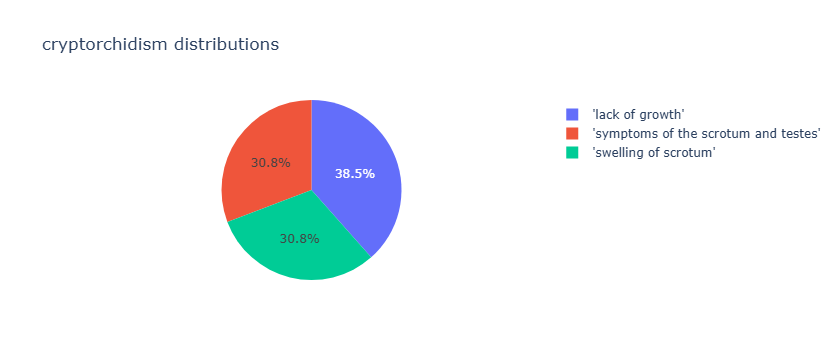

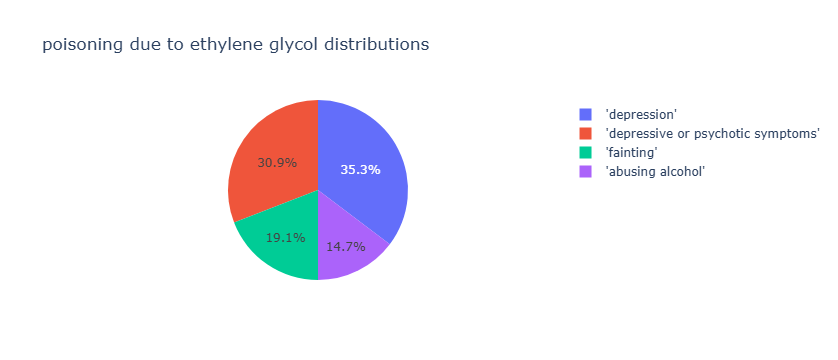

...

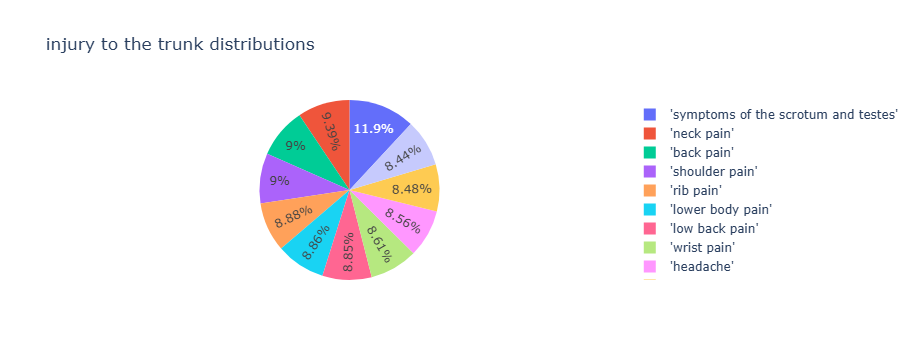

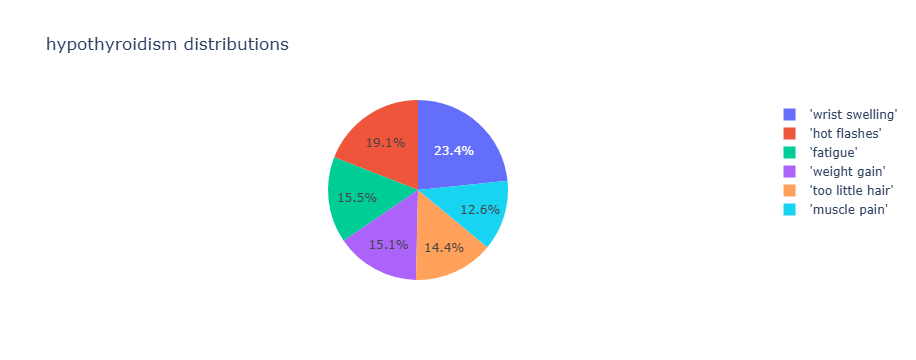

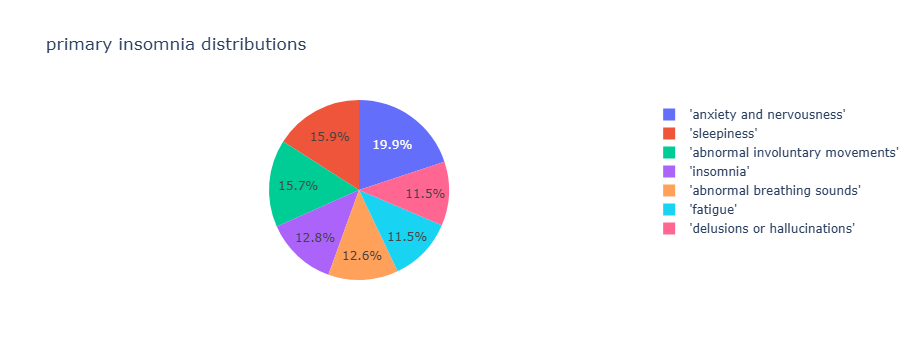

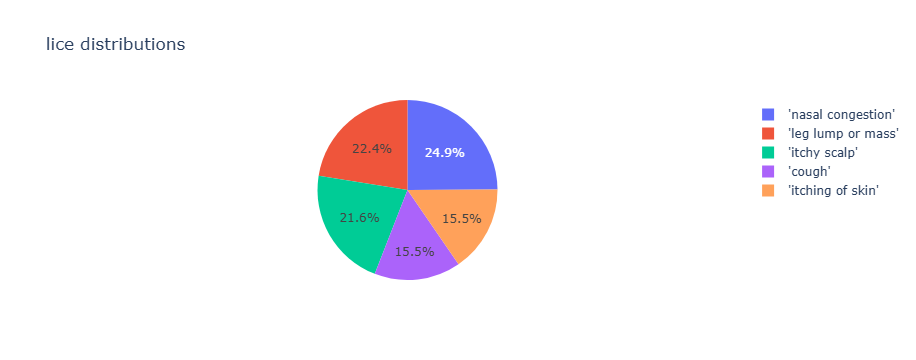

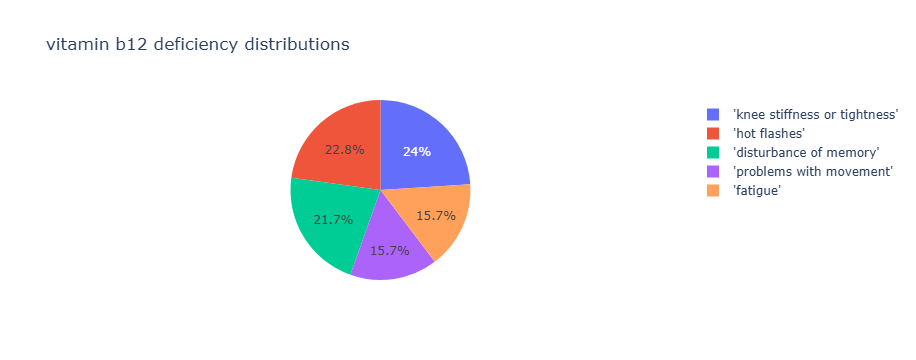

WARNING	Thread(Thread-299 (run)) choreographer.browser_async:browser_async.py:_close()- Resorting to unclean kill browser.


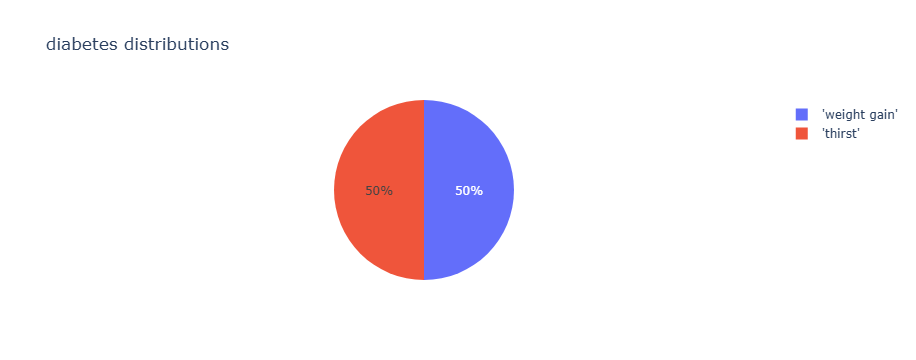

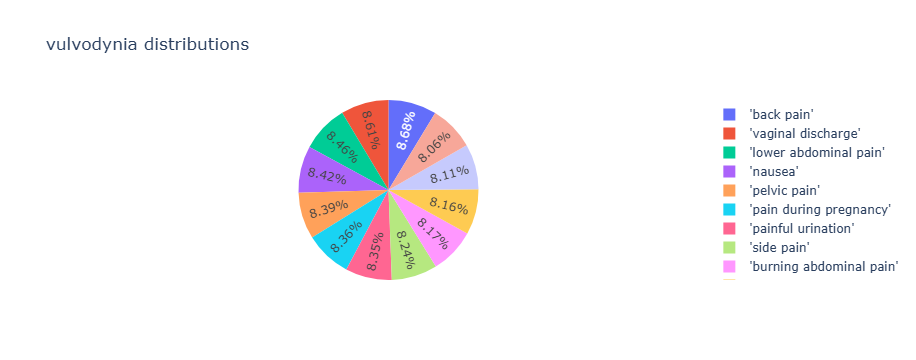

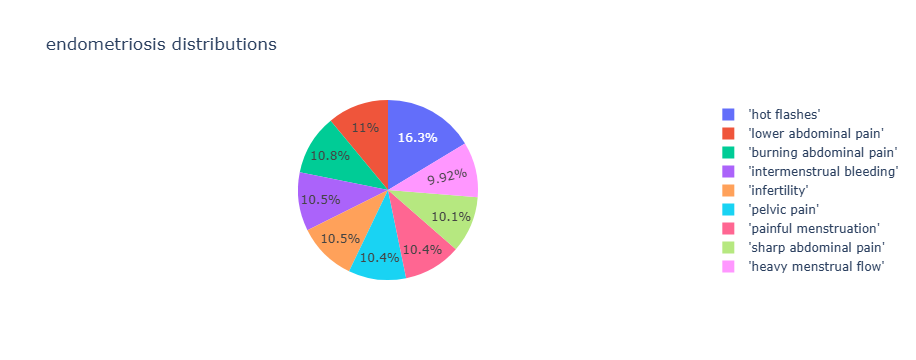

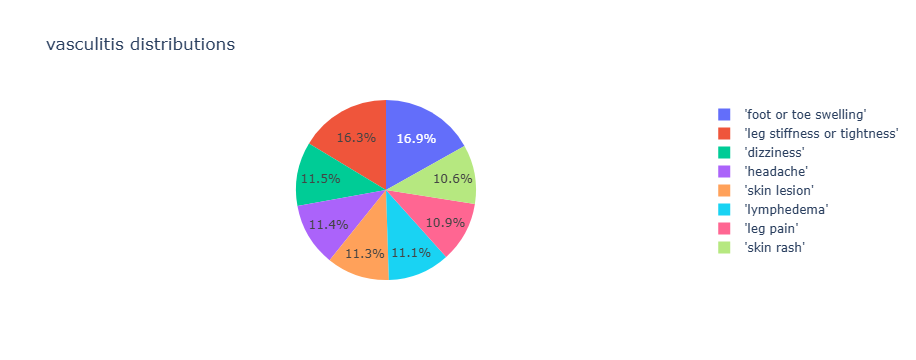

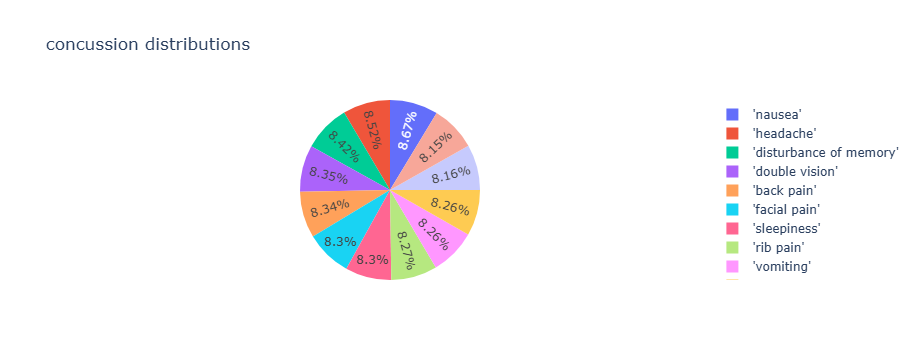

...

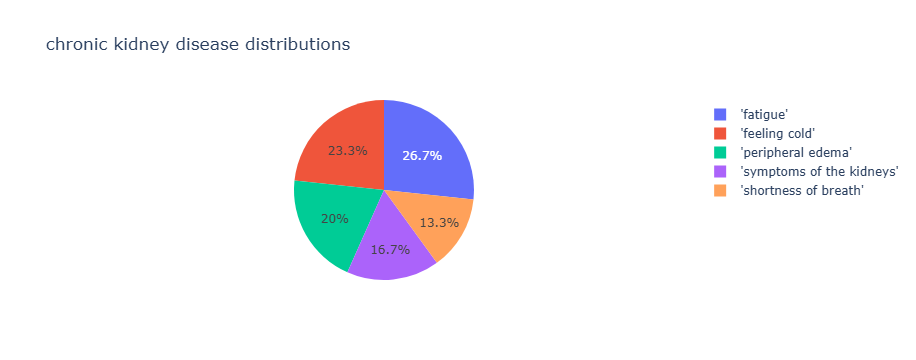

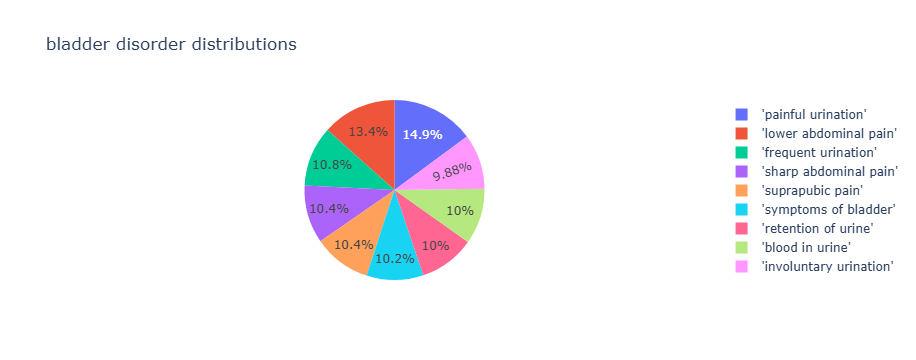

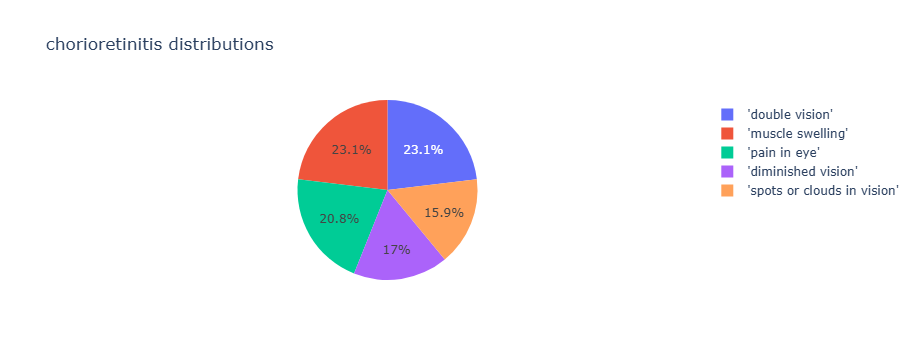

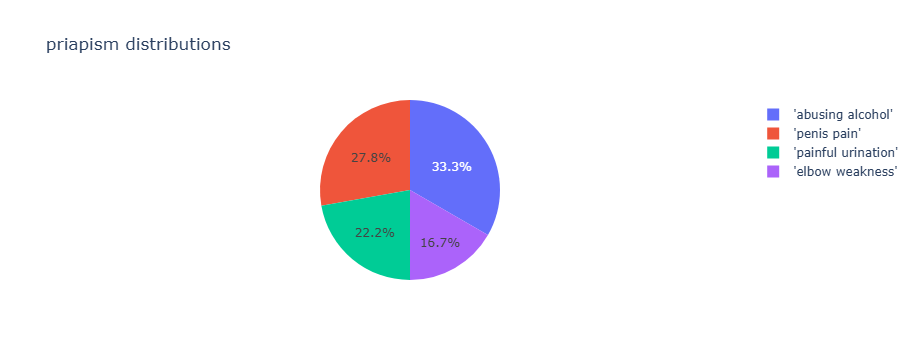

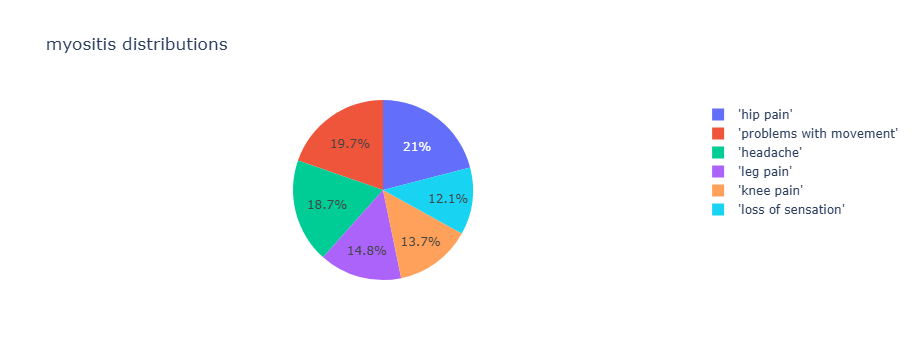

WARNING	Thread(Thread-321 (run)) choreographer.browser_async:browser_async.py:_close()- Resorting to unclean kill browser.


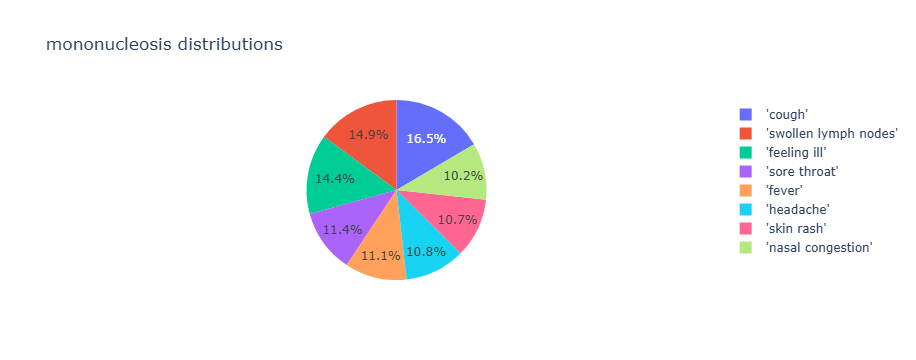

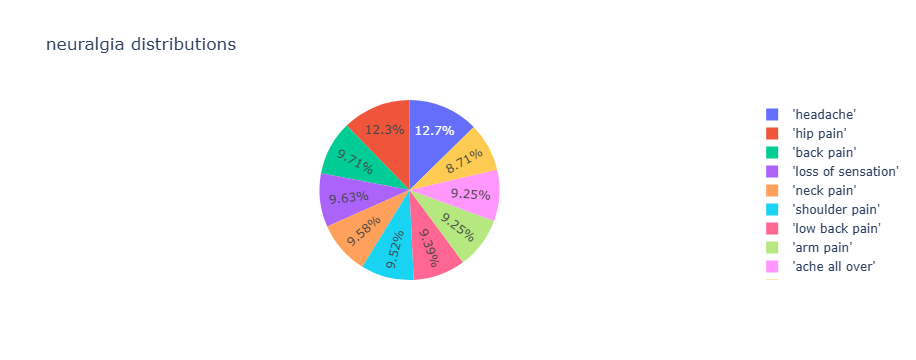

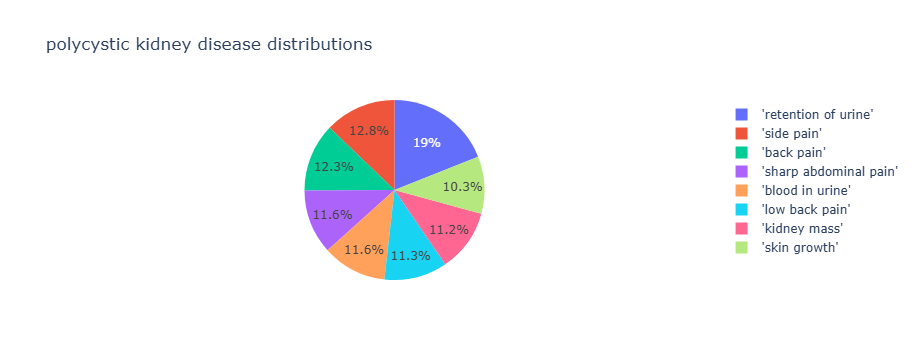

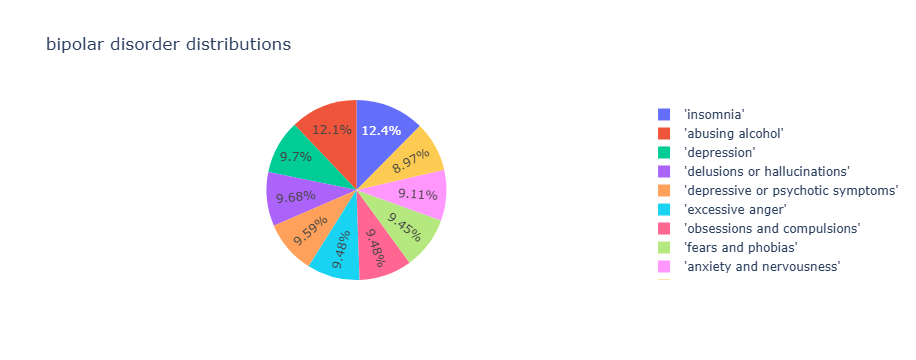

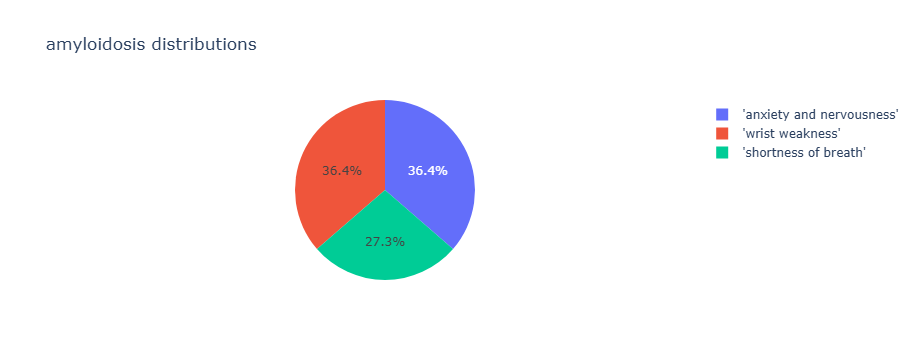

...

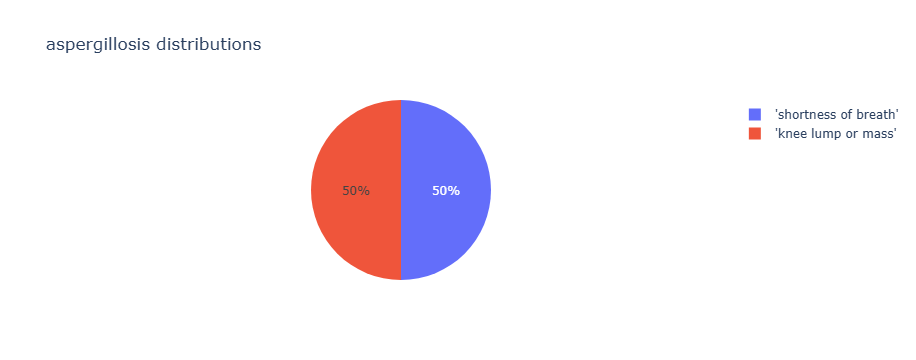

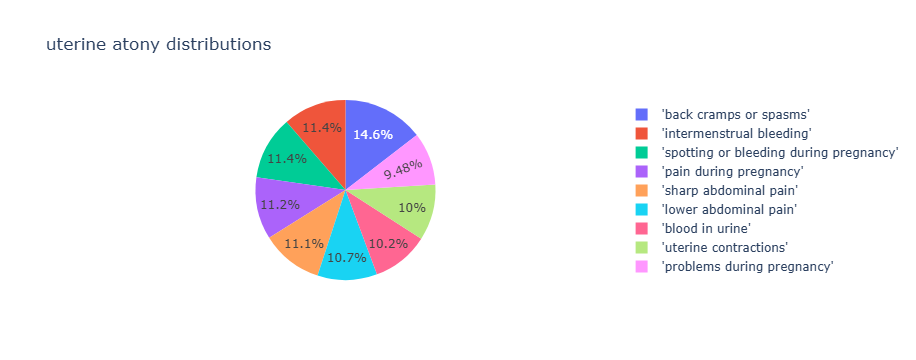

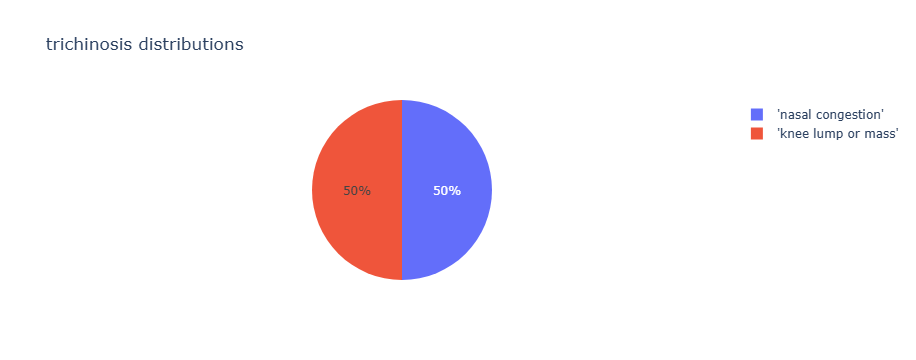

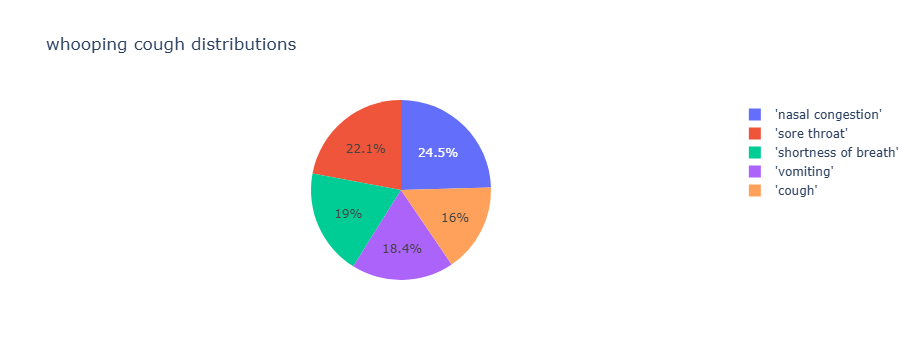

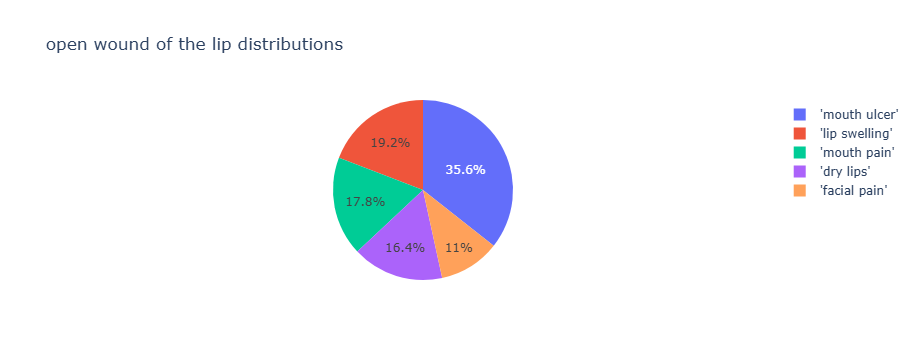

WARNING	Thread(Thread-771 (run)) choreographer.browser_async:browser_async.py:_close()- Resorting to unclean kill browser.


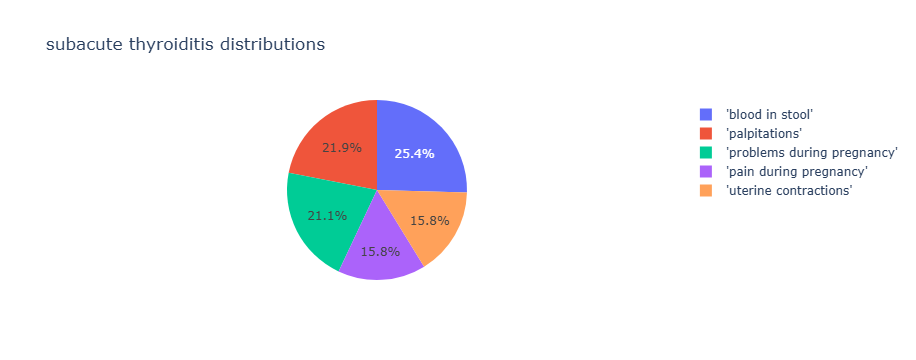

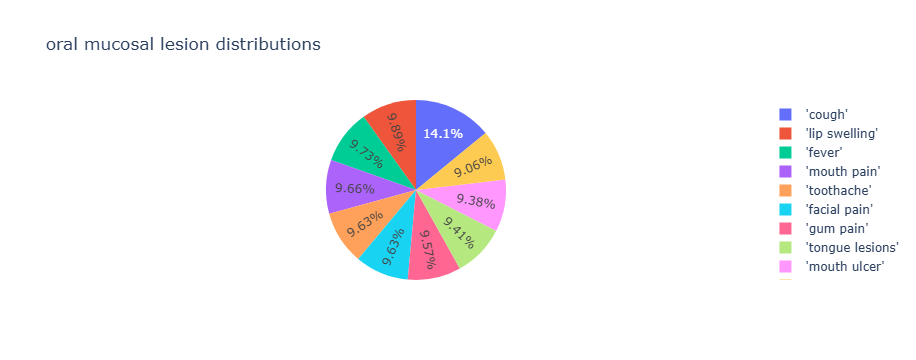

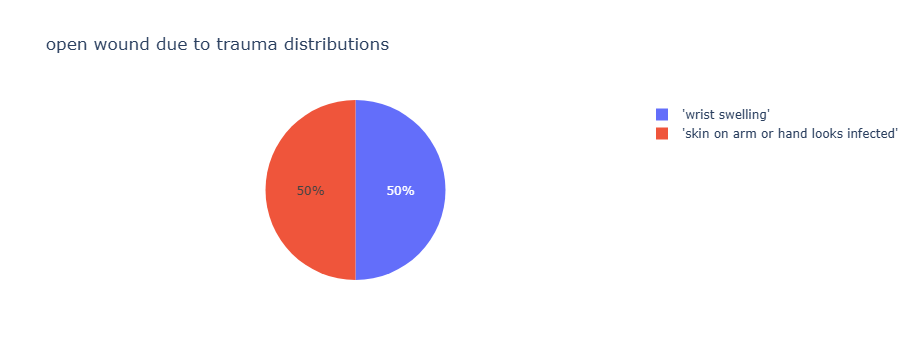

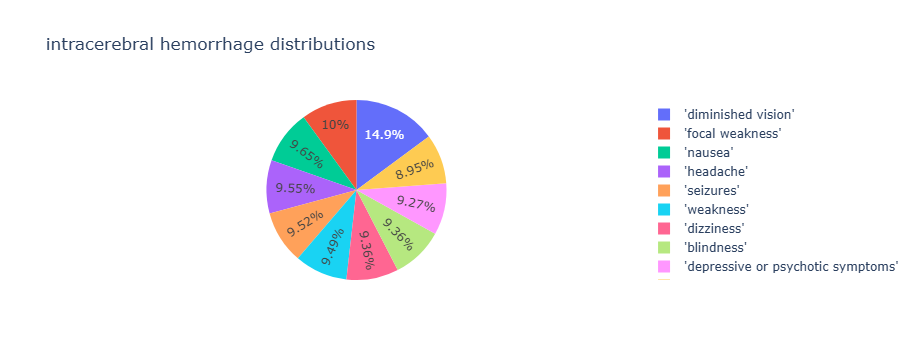

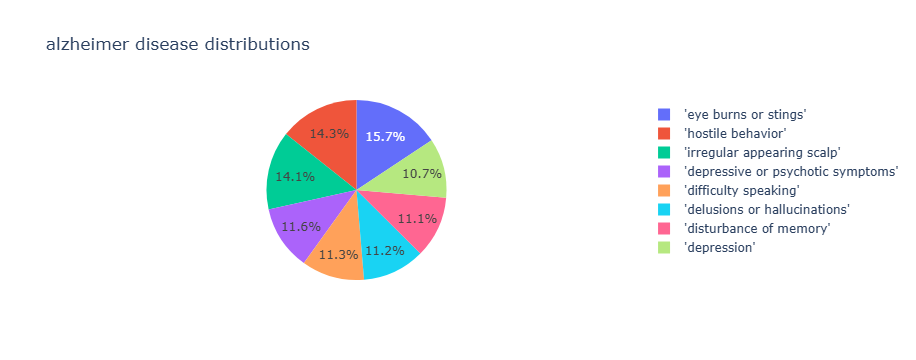

...

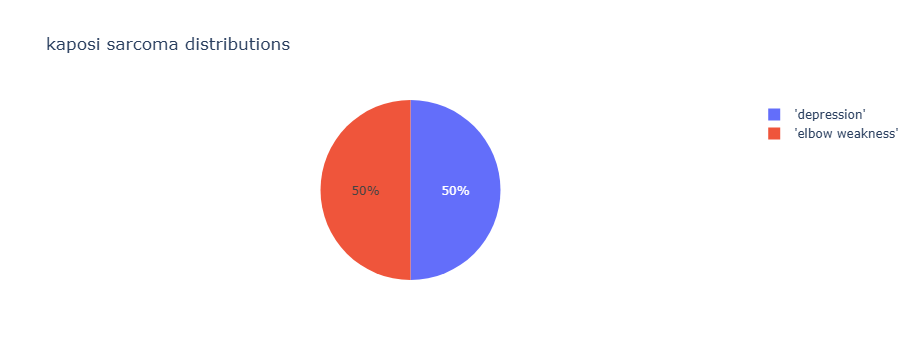

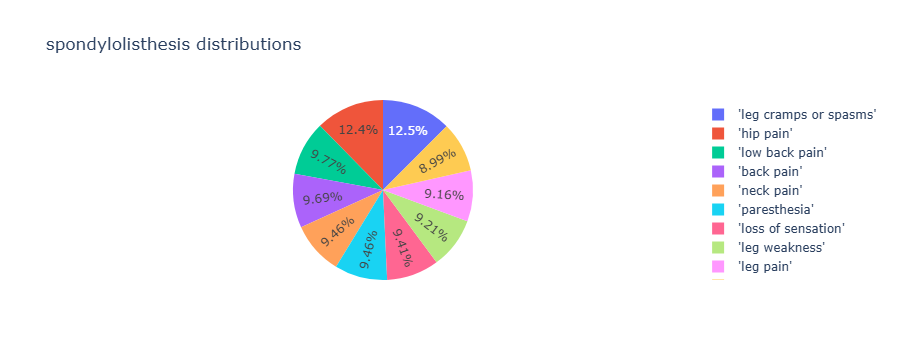

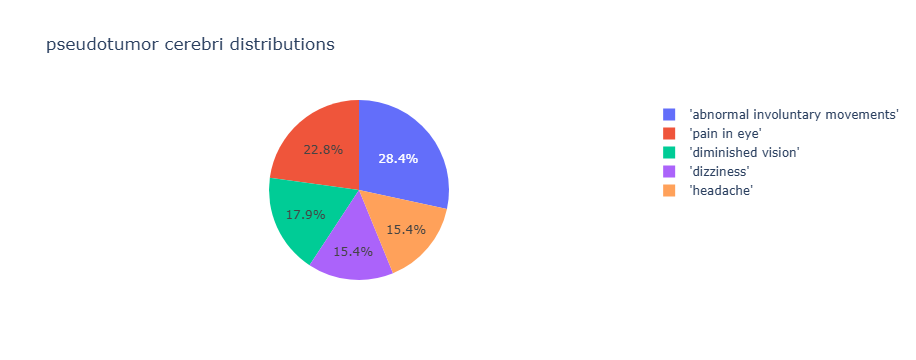

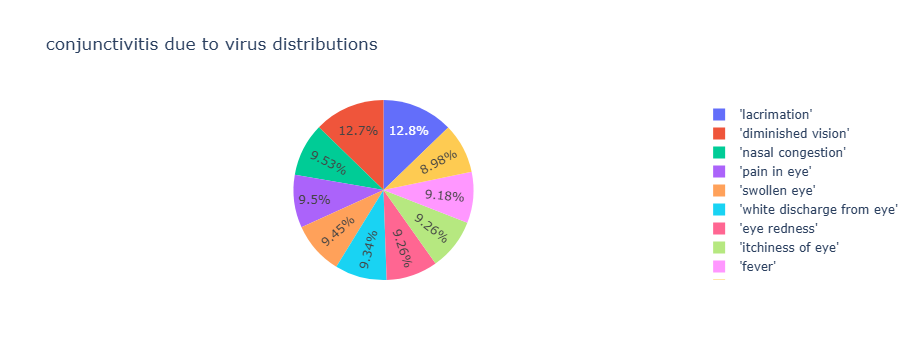

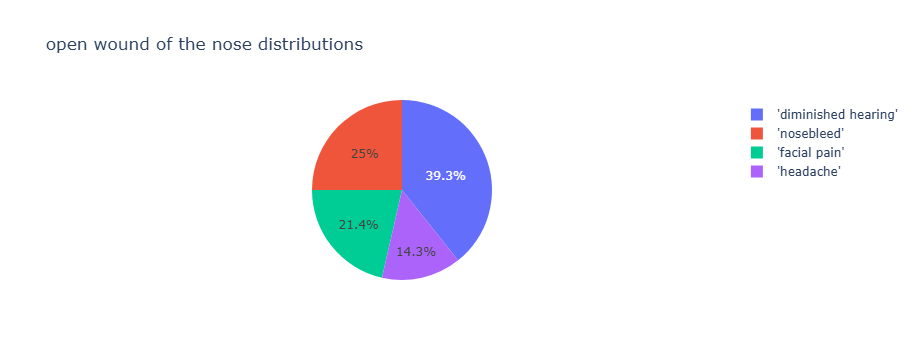

In [5]:
for j in diseases:
    data = pd.read_csv(f"Data/Preprocessed_each_diseases_symptoms/{j}.csv")
    sym_list = []
    for i in data.columns[:-1]:
        sym_list.extend(data[i].dropna())
        symptoms = [str(i).strip("[]") for i in sym_list]
        counts = Counter(symptoms)
    fig = pxs.pie(values=counts.values(),names=counts.keys(),title=f"{j} distributions")
    fig.write_image(f"Visuals/EDA/{j}_distributions.png",height=650,width=900,scale=1)
    fig.show()